In [4]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 61.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 58.0 MB/s eta 0:00:00


In [2]:
!pip install better_profanity

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.1/46.1 kB 2.6 MB/s eta 0:00:00


In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point, Polygon
import os
from better_profanity import profanity

In [3]:
pd.set_option('display.max_columns',None,'display.max_rows',None)

In [112]:
place_merged = pd.read_csv('/content/place_merged.csv')

In [113]:
place_merged.head(5)

,id,url,place_type,name,full_name,country_code,country,contained_within,bounding_box.type,bounding_box.coordinates,tweet_id,Club_Name
0,011d05962ca1154c,https://api.twitter.com/1.1/geo/id/011d05962ca...,admin,Manicaland,"Manicaland, Zimbabwe",ZW,Zimbabwe,[],Polygon,"[[[31.1875684, -21.3396758], [33.0681312, -21....",NaN,Arsenal
1,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,[],Polygon,"[[[32.4166234, 0.1648531], [32.7216969, 0.1648...",NaN,Arsenal
2,00e55e2b4c491c5f,https://api.twitter.com/1.1/geo/id/00e55e2b4c4...,city,Abuja,"Abuja, Nigeria",NG,Nigeria,[],Polygon,"[[[7.3045544, 8.961887], [7.5436339, 8.961887]...",NaN,Arsenal
3,3178a2f5b3c63ea4,https://api.twitter.com/1.1/geo/id/3178a2f5b3c...,city,Elche,"Elche, Spain",ES,Spain,[],Polygon,"[[[-0.7824914, 38.1277872], [-0.5101526, 38.12...",NaN,Arsenal
4,01898b4d7e969f7d,https://api.twitter.com/1.1/geo/id/01898b4d7e9...,city,Loganville,"Loganville, GA",US,United States,[],Polygon,"[[[-83.935379, 33.80308], [-83.860408, 33.8030...",NaN,Arsenal


In [114]:
place_merged['tweet_id'].fillna(0,inplace=True)

In [116]:
place_merged['tweet_id'] = place_merged['tweet_id'].astype('int')

In [8]:
place_merged.shape

(568, 12)

In [9]:
place_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568 entries, 0 to 567
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   id                        568 non-null    object
 1   url                       568 non-null    object
 2   place_type                568 non-null    object
 3   name                      568 non-null    object
 4   full_name                 568 non-null    object
 5   country_code              568 non-null    object
 6   country                   568 non-null    object
 7   contained_within          568 non-null    object
 8   bounding_box.type         568 non-null    object
 9   bounding_box.coordinates  568 non-null    object
 10  tweet_id                  568 non-null    int64 
 11  Club_Name                 568 non-null    object
dtypes: int64(1), object(11)
memory usage: 53.4+ KB


In [10]:
#place_merged['tweet_id'].fillna('Tweet ID Not Available',inplace=True)

In [12]:
place_merged['full_name'].nunique()

206

In [13]:
place_merged['bounding_box.coordinates'].nunique()

207

In [14]:
coord_group = place_merged.groupby(['bounding_box.coordinates']).count()

In [16]:
coord_group_df = coord_group.reset_index()

In [18]:
coord_group_df = coord_group_df[['bounding_box.coordinates','id']]

In [19]:
full_name_df = place_merged.groupby(['full_name','bounding_box.coordinates']).count()

In [20]:
full_name_df.reset_index(inplace=True)

In [21]:
full_name_df = full_name_df[['full_name','bounding_box.coordinates','id']]

In [223]:
full_name_df[full_name_df['full_name']=='Nairobi, Kenya']

,full_name,bounding_box.coordinates,Tweet Count,Centroids,Longitude,Latitude
143,"Nairobi, Kenya","[[36.6645733, -1.3890532], [37.0626672, -1.389...",3,"[36.86362025, -1.27486335]",36.863620,-1.274863
144,"Nairobi, Kenya","[[36.6645733, -1.4446849], [37.1050092, -1.444...",2,"[36.88479125, -1.3026792]",36.884791,-1.302679


In [23]:
full_name_df.rename(columns={'id':'Tweet Count'},inplace=True)

In [24]:
def convert_string_list(text):
  text = text.replace('[[','[')
  text = text.replace(']]',']')
  text = text.replace(']','] ')
  text = text.replace('[[','[')
  text = text.replace('] ] ',']')


  dummy_list = []
  for i in text.split(' , '):
    dummy_list.append(i)


  main_list = []
  for i in dummy_list:
    i=i.replace('[','')
    i=i.replace(']','')
    i_list = i.split(', ')
    temp_list = []
    for j in i_list:
      temp_list.append(float(j))
    if temp_list not in main_list:
      main_list.append(temp_list)
  return main_list

In [25]:
full_name_df['bounding_box.coordinates'] = full_name_df['bounding_box.coordinates'].apply(lambda x: convert_string_list(x))

In [250]:
def centroid(list_points):
    if len(list_points)<2:
      x = [p[0] for p in full_name_df.iloc[0]['bounding_box.coordinates']]
      y = [p[1] for p in full_name_df.iloc[0]['bounding_box.coordinates']]
      centroid = x+y
      return centroid
    else:
      x_coords = [p[0] for p in list_points]
      set_x = list(set(x_coords))
      y_coords = [p[1] for p in list_points]
      set_y = list(set(y_coords))
      #print(set_x)
      #print(set_y)
      len_x = len(set_x)
      len_y = len(set_y)
      centroid_x = sum(set_x)/len_x
      centroid_y = sum(set_y)/len_y
      return [centroid_x, centroid_y]

In [251]:
full_name_df['Centroids'] = full_name_df['bounding_box.coordinates'].apply(lambda x: centroid(x))

In [252]:
full_name_df['Longitude'] = full_name_df['Centroids'].apply(lambda x: x[0])
full_name_df['Latitude'] = full_name_df['Centroids'].apply(lambda x: x[1])

In [253]:
place_merged['bounding_box.coordinates'] = place_merged['bounding_box.coordinates'].apply(lambda x: convert_string_list(x))

In [254]:
place_merged['Centroids'] = place_merged['bounding_box.coordinates'].apply(lambda x: centroid(x))

In [255]:
place_merged['Longitude'] = place_merged['Centroids'].apply(lambda x: x[0])
place_merged['Latitude'] = place_merged['Centroids'].apply(lambda x: x[1])

In [256]:
place_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568 entries, 0 to 567
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id                        568 non-null    object 
 1   url                       568 non-null    object 
 2   place_type                568 non-null    object 
 3   name                      568 non-null    object 
 4   full_name                 568 non-null    object 
 5   country_code              568 non-null    object 
 6   country                   568 non-null    object 
 7   contained_within          568 non-null    object 
 8   bounding_box.type         568 non-null    object 
 9   bounding_box.coordinates  568 non-null    object 
 10  tweet_id                  568 non-null    int64  
 11  Club_Name                 568 non-null    object 
 12  Centroids                 568 non-null    object 
 13  Longitude                 568 non-null    float64
 14  Latitude  

In [257]:
place_merged['id'] = place_merged['id'].astype(str)

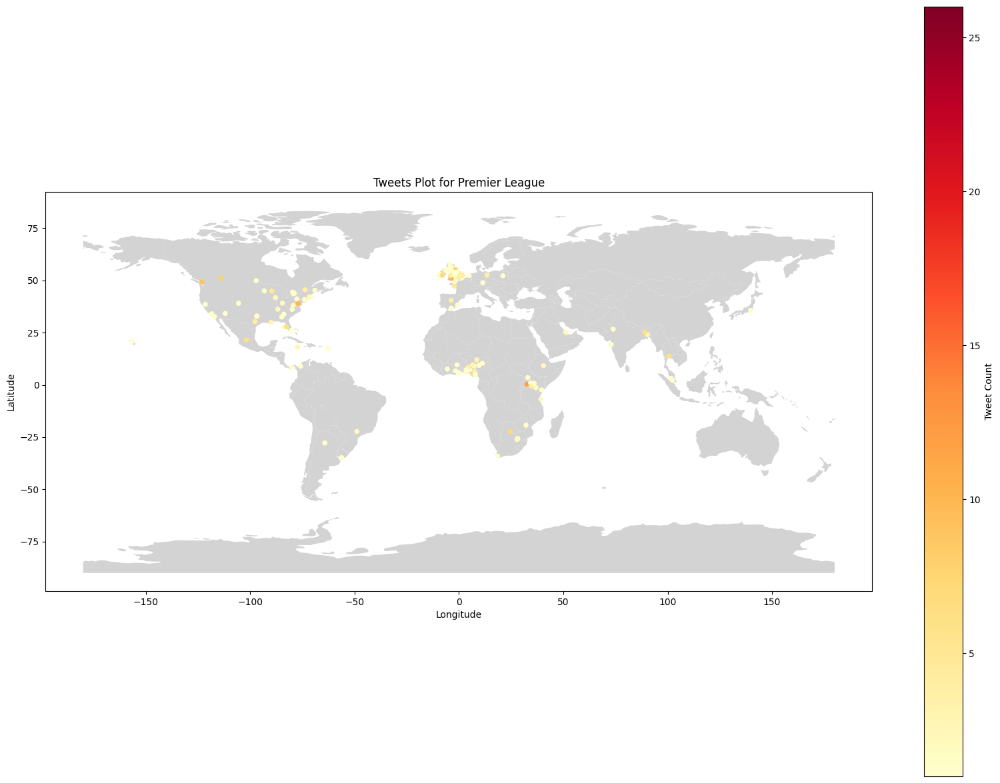

In [258]:
fig, ax = plt.subplots(figsize=(20,15))
countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
countries.plot(color="lightgrey",ax=ax)
full_name_df.plot(x="Longitude", y="Latitude", kind="scatter", colormap="YlOrRd", 
        title="Tweets Plot for Premier League", c='Tweet Count',
        ax=ax);

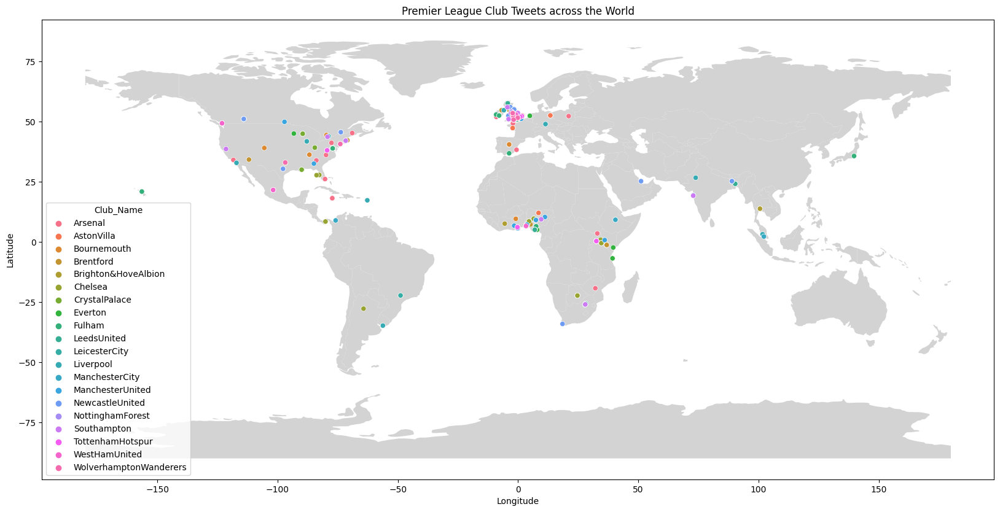

In [259]:
fig, ax = plt.subplots(figsize=(20,15))
countries = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
countries.plot(color="lightgrey",ax=ax)
# place_merged.plot(x="Longitude", y="Latitude", kind="scatter", colormap="YlOrRd", 
#         title="Tweets Plot for Premier League", c='Tweet Count',
#         ax=ax);


sns.scatterplot(data=place_merged,x='Longitude',y='Latitude',hue='Club_Name',ax=ax);
plt.title('Premier League Club Tweets across the World');

In [260]:
place_merged['full_name'].value_counts().head(10)

South East, England            26
Manchester, England            16
Bournemouth, England           15
Ikeja, Nigeria                 15
Kingsbridge, England           12
Kampala, Uganda                12
Liverpool, England             11
Washington, DC                 10
South West, England            10
Vancouver, British Columbia     9
Name: full_name, dtype: int64

In [261]:
club_merged = pd.read_csv('/content/club_merged.csv')

In [262]:
club_merged.head()

,created_at,id,full_text,retweet_count,favorite_count,user.id,user.name,user.location,user.followers_count,user.friends_count,user.favourites_count,Club_Name
0,Wed Mar 08 16:52:50 +0000 2023,1633511103563984896,He's Back💚✅❕❕\n@Arsenal \n#Gunners \n#Jesus ht...,0,0,1537893091725570048,suleiman usman sokomba,NaN,18,208,459,Arsenal
1,Wed Mar 08 16:52:47 +0000 2023,1633511091283140634,@Rory_Talks_Ball Good luck Arsenal good,0,0,1622132260446109697,Abdui Jelili opeyemi Opeyemi,NaN,3,111,62,Arsenal
2,Wed Mar 08 16:52:44 +0000 2023,1633511076942807040,"@Arsenal_Blog @Lionesses Not different hours, ...",0,0,1349293850,Vicki ❤️📚🍫,"England, United Kingdom",244,675,9407,Arsenal
3,Wed Mar 08 16:52:41 +0000 2023,1633511064846454784,hector back w his arsenal 2014 haircut is driv...,0,0,1556714916194799620,🌊,fcb • team lh,205,176,7192,Arsenal
4,Wed Mar 08 16:52:37 +0000 2023,1633511047708688385,@MisssMelina @Arsenal Happy women’s day Mel,0,0,875117165875212288,RICE KILO,Bamenda,364,805,20825,Arsenal


In [263]:
club_merged.shape

(12754, 12)

In [264]:
club_merged = club_merged.drop_duplicates(subset=['id','full_text'],keep='first')

In [265]:
club_merged.shape

(10920, 12)

In [266]:
club_group = club_merged.groupby('Club_Name')

In [267]:
club_group.count()

,created_at,id,full_text,retweet_count,favorite_count,user.id,user.name,user.location,user.followers_count,user.friends_count,user.favourites_count
Club_Name,,,,,,,,,,,
Arsenal,829,829,829,829,829,829,829,516,829,829,829
AstonVilla,501,501,501,501,501,501,501,299,501,501,501
Bournemouth,712,712,712,712,712,712,712,442,712,712,712
Brentford,675,675,675,675,675,675,675,377,675,675,675
Brighton&HoveAlbion,500,500,500,500,500,500,500,367,500,500,500
Chelsea,773,773,773,773,773,773,773,476,773,773,773
CrystalPalace,468,468,468,468,468,468,468,284,468,468,468
Everton,654,654,654,654,654,654,654,382,654,654,654
Fulham,654,654,654,654,654,654,654,397,654,654,654


In [268]:
club_group.size()

Club_Name
Arsenal                   829
AstonVilla                501
Bournemouth               712
Brentford                 675
Brighton&HoveAlbion       500
Chelsea                   773
CrystalPalace             468
Everton                   654
Fulham                    654
LeedsUnited               438
LeicesterCity             430
Liverpool                 708
ManchesterCity            451
ManchesterUnited          430
NewcastleUnited           407
NottinghamForest          397
Southampton               647
TottenhamHotspur          427
WestHamUnited             342
WolverhamptonWanderers    477
dtype: int64

In [269]:
club_group.sum()['retweet_count'].sort_values(ascending=False)

<ipython-input-269-205224dc4725>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  club_group.sum()['retweet_count'].sort_values(ascending=False)


Club_Name
ManchesterUnited          503
Brighton&HoveAlbion       402
WolverhamptonWanderers    401
ManchesterCity            395
TottenhamHotspur          371
LeedsUnited               339
Brentford                 284
AstonVilla                275
Bournemouth               272
NottinghamForest          209
NewcastleUnited           206
CrystalPalace             194
Southampton               166
LeicesterCity             157
WestHamUnited             120
Fulham                    116
Everton                    83
Arsenal                    58
Liverpool                  53
Chelsea                    46
Name: retweet_count, dtype: int64

In [270]:
club_group.sum()['favorite_count'].sort_values(ascending=False)

<ipython-input-270-3b16a0521120>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  club_group.sum()['favorite_count'].sort_values(ascending=False)


Club_Name
Brighton&HoveAlbion       4933
ManchesterCity            4617
Bournemouth               4346
WolverhamptonWanderers    4080
TottenhamHotspur          3981
AstonVilla                3621
ManchesterUnited          3429
NottinghamForest          3415
LeedsUnited               3125
NewcastleUnited           2901
Brentford                 2340
LeicesterCity             2186
CrystalPalace             1989
Southampton               1886
Fulham                    1502
Everton                   1176
WestHamUnited              882
Chelsea                    477
Arsenal                    348
Liverpool                  313
Name: favorite_count, dtype: int64

In [271]:
club_group.sum()['user.followers_count'].sort_values(ascending=False)

<ipython-input-271-0ba738583852>:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  club_group.sum()['user.followers_count'].sort_values(ascending=False)


Club_Name
Southampton               84896383
NottinghamForest          66446293
AstonVilla                61446292
Everton                   45173418
Liverpool                 43131742
ManchesterUnited          28757733
WolverhamptonWanderers    23024378
ManchesterCity            17865687
NewcastleUnited           17358931
WestHamUnited             17137465
LeicesterCity             16045058
Bournemouth               12526477
Fulham                    11682657
TottenhamHotspur          10367665
CrystalPalace              9637109
Chelsea                    8763245
Arsenal                    7824962
Brentford                  5893084
Brighton&HoveAlbion        4529072
LeedsUnited                3310353
Name: user.followers_count, dtype: int64

In [272]:
club_merged.describe()

,id,retweet_count,favorite_count,user.id,user.followers_count,user.friends_count,user.favourites_count
count,1.092000e+04,10920.000000,10920.000000,1.092000e+04,1.092000e+04,10920.000000,10920.000000
mean,1.637768e+18,0.425824,4.720421,7.767072e+17,4.540458e+04,1258.643956,18627.898718
std,4.392779e+15,3.846133,48.873545,6.749382e+17,8.435309e+05,5594.855923,46116.822070
min,1.632642e+18,0.000000,0.000000,6.124730e+05,0.000000e+00,0.000000,0.000000
25%,1.633529e+18,0.000000,0.000000,5.978442e+08,8.900000e+01,127.000000,136.000000
50%,1.635001e+18,0.000000,0.000000,9.502471e+17,4.410000e+02,405.000000,2431.500000
75%,1.643676e+18,0.000000,1.000000,1.445428e+18,2.266250e+03,1169.000000,15915.750000
max,1.644414e+18,125.000000,2063.000000,1.644404e+18,3.970409e+07,256987.000000,670580.000000


<Axes: xlabel='retweet_count', ylabel='user.followers_count'>

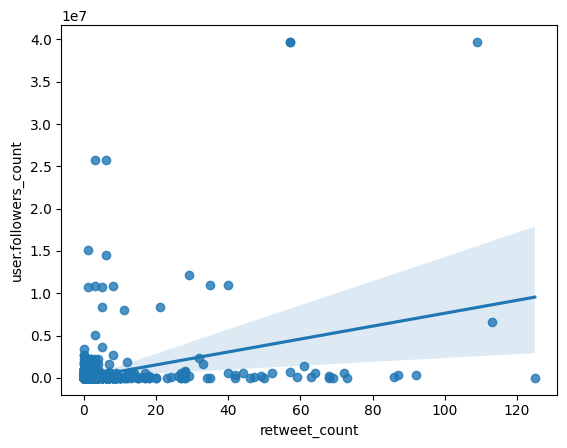

In [273]:
sns.regplot(data=club_merged,y='user.followers_count',x='retweet_count')

<Axes: xlabel='user.favourites_count', ylabel='user.followers_count'>

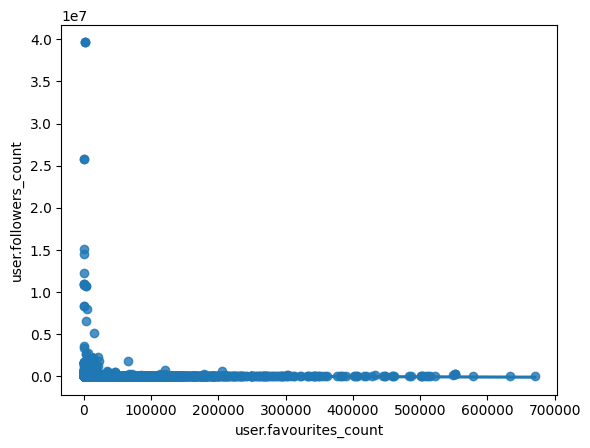

In [274]:
sns.regplot(data=club_merged,y='user.followers_count',x='user.favourites_count')

<Axes: xlabel='user.favourites_count', ylabel='user.friends_count'>

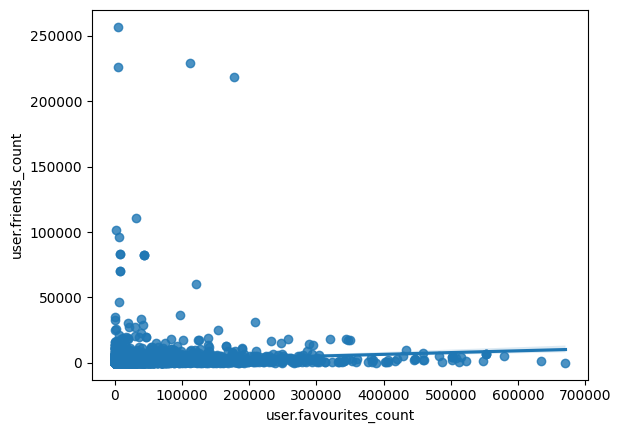

In [275]:
sns.regplot(data=club_merged,y='user.friends_count',x='user.favourites_count')

<Axes: >

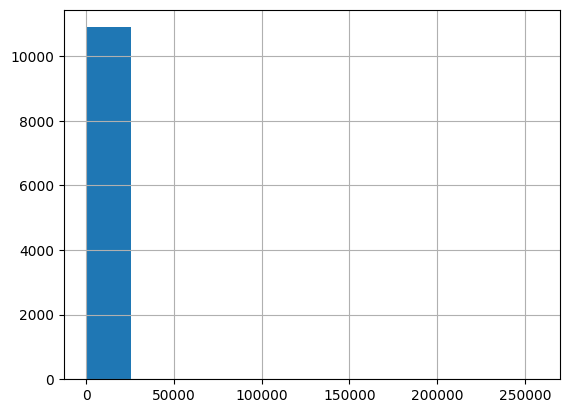

In [276]:
club_merged['user.friends_count'].hist()

In [277]:
import re

# Sentiment Analysis







### Approach - 1

In [57]:
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


In [58]:
sid = SentimentIntensityAnalyzer()

In [59]:
nltk.download('words')
words = set(nltk.corpus.words.words())

[nltk_data] Downloading package words to /root/nltk_data...
[nltk_data]   Unzipping corpora/words.zip.


In [62]:
def cleaner(tweet):
    tweet = re.sub("@[A-Za-z0-9]+","",tweet) #Remove @ sign
    tweet = re.sub(r"(?:\@|http?\://|https?\://|www)\S+", "", tweet) #Remove http links
    tweet = " ".join(tweet.split())
    tweet = tweet.replace("#", "").replace("_", " ") #Remove hashtag sign but keep the text
    tweet = " ".join(w for w in nltk.wordpunct_tokenize(tweet)
         if w.lower() in words or not w.isalpha())
    return tweet

In [66]:
def remove_emojis(data):
    emoj = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U00002500-\U00002BEF"  # chinese char
        u"\U00002702-\U000027B0"
        u"\U00002702-\U000027B0"
        u"\U000024C2-\U0001F251"
        u"\U0001f926-\U0001f937"
        u"\U00010000-\U0010ffff"
        u"\u2640-\u2642" 
        u"\u2600-\u2B55"
        u"\u200d"
        u"\u23cf"
        u"\u23e9"
        u"\u231a"
        u"\ufe0f"  
        u"\u3030"
                      "]+", re.UNICODE)
    return re.sub(emoj, '', data)

In [65]:
def sentiment_category(sentiment):
    label = ''
    if(sentiment>0):
        label = 'positive'
    elif(sentiment == 0):
        label = 'neutral'
    else:
        label = 'negative'
    return(label)

In [141]:
def calculate_polarity(df):
  list1 = []
  for i in df['clean_text_2']:
    list1.append((sid.polarity_scores(str(i)))['compound'])
  return list1

In [278]:
club_merged['clean_text'] = club_merged['full_text'].apply(cleaner)

In [280]:
club_merged['clean_text_2'] = club_merged['clean_text'].apply(remove_emojis)

In [281]:
list1 = calculate_polarity(club_merged)
club_merged['sentiment'] = pd.Series(list1)

In [282]:
club_merged['sentiment_category'] = club_merged['sentiment'].apply(sentiment_category)

In [283]:
club_merged

,created_at,id,full_text,retweet_count,favorite_count,user.id,user.name,user.location,user.followers_count,user.friends_count,user.favourites_count,Club_Name,clean_text,clean_text_2,sentiment,sentiment_category
0,Wed Mar 08 16:52:50 +0000 2023,1633511103563984896,He's Back💚✅❕❕\n@Arsenal \n#Gunners \n#Jesus ht...,0,0,1537893091725570048,suleiman usman sokomba,NaN,18,208,459,Arsenal,He ' s Back 💚✅❕❕,He ' s Back,0.0000,neutral
1,Wed Mar 08 16:52:47 +0000 2023,1633511091283140634,@Rory_Talks_Ball Good luck Arsenal good,0,0,1622132260446109697,Abdui Jelili opeyemi Opeyemi,NaN,3,111,62,Arsenal,Ball Good luck Arsenal good,Ball Good luck Arsenal good,0.8316,positive
2,Wed Mar 08 16:52:44 +0000 2023,1633511076942807040,"@Arsenal_Blog @Lionesses Not different hours, ...",0,0,1349293850,Vicki ❤️📚🍫,"England, United Kingdom",244,675,9407,Arsenal,"Not different , but possibly in some different...","Not different , but possibly in some different...",0.0000,neutral
3,Wed Mar 08 16:52:41 +0000 2023,1633511064846454784,hector back w his arsenal 2014 haircut is driv...,0,0,1556714916194799620,🌊,fcb • team lh,205,176,7192,Arsenal,hector back w his arsenal 2014 haircut is driv...,hector back w his arsenal 2014 haircut is driv...,0.0000,neutral
4,Wed Mar 08 16:52:37 +0000 2023,1633511047708688385,@MisssMelina @Arsenal Happy women’s day Mel,0,0,875117165875212288,RICE KILO,Bamenda,364,805,20825,Arsenal,Happy ’ s day Mel,Happy ’ s day Mel,0.5719,positive
5,Wed Mar 08 16:52:33 +0000 2023,1633511030059077633,Arsenal fans anticipate return of Jesus https:...,0,0,3010719202,News Round The Clock,NaN,6162,227,3371,Arsenal,Arsenal anticipate return of,Arsenal anticipate return of,0.0000,neutral
6,Wed Mar 08 16:52:32 +0000 2023,1633511028012064769,Cancelo to Arsenal ? Who says no ? I love Ben ...,0,0,1279449699431469057,arteta’s red army ! 🔴⚪️,"Manchester, England",114,113,435,Arsenal,to Arsenal ? Who no ? I love Ben White but I d...,to Arsenal ? Who no ? I love Ben White but I d...,0.9054,positive
7,Wed Mar 08 16:52:32 +0000 2023,1633511025143324672,@BaaBaaBet @realmadriden @Arsenal @AvaxScheun ...,0,1,160572781,zizou.avax,NaN,2,2,11,Arsenal,See now . From top manager to mediocre because...,See now . From top manager to mediocre because...,0.2023,positive
8,Wed Mar 08 16:52:27 +0000 2023,1633511006810042368,I never thought that what is in manga can only...,0,0,1208728147136524288,Raihansyah.A.D,NaN,8,19,18,Arsenal,I never thought that what is in manga can only...,I never thought that what is in manga can only...,0.0000,neutral
9,Wed Mar 08 16:52:26 +0000 2023,1633511001504063521,@Sharkfinn721 @TrollFootball This a pure Arsen...,0,0,1565596721819828225,Swalehy @Pax Apuuli,Fortportal,57,51,16873,Arsenal,This a pure Arsenal Mentality no wonder 🚮,This a pure Arsenal Mentality no wonder,-0.2960,negative


In [284]:
club_merged_sentiment = club_merged[['id','created_at','full_text','clean_text','clean_text_2','sentiment','sentiment_category']]
club_merged_sentiment.head()

,id,created_at,full_text,clean_text,clean_text_2,sentiment,sentiment_category
0,1633511103563984896,Wed Mar 08 16:52:50 +0000 2023,He's Back💚✅❕❕\n@Arsenal \n#Gunners \n#Jesus ht...,He ' s Back 💚✅❕❕,He ' s Back,0.0000,neutral
1,1633511091283140634,Wed Mar 08 16:52:47 +0000 2023,@Rory_Talks_Ball Good luck Arsenal good,Ball Good luck Arsenal good,Ball Good luck Arsenal good,0.8316,positive
2,1633511076942807040,Wed Mar 08 16:52:44 +0000 2023,"@Arsenal_Blog @Lionesses Not different hours, ...","Not different , but possibly in some different...","Not different , but possibly in some different...",0.0000,neutral
3,1633511064846454784,Wed Mar 08 16:52:41 +0000 2023,hector back w his arsenal 2014 haircut is driv...,hector back w his arsenal 2014 haircut is driv...,hector back w his arsenal 2014 haircut is driv...,0.0000,neutral
4,1633511047708688385,Wed Mar 08 16:52:37 +0000 2023,@MisssMelina @Arsenal Happy women’s day Mel,Happy ’ s day Mel,Happy ’ s day Mel,0.5719,positive


In [285]:
club_merged_sentiment[club_merged_sentiment['sentiment_category']=='positive']

,id,created_at,full_text,clean_text,clean_text_2,sentiment,sentiment_category
1,1633511091283140634,Wed Mar 08 16:52:47 +0000 2023,@Rory_Talks_Ball Good luck Arsenal good,Ball Good luck Arsenal good,Ball Good luck Arsenal good,0.8316,positive
4,1633511047708688385,Wed Mar 08 16:52:37 +0000 2023,@MisssMelina @Arsenal Happy women’s day Mel,Happy ’ s day Mel,Happy ’ s day Mel,0.5719,positive
6,1633511028012064769,Wed Mar 08 16:52:32 +0000 2023,Cancelo to Arsenal ? Who says no ? I love Ben ...,to Arsenal ? Who no ? I love Ben White but I d...,to Arsenal ? Who no ? I love Ben White but I d...,0.9054,positive
7,1633511025143324672,Wed Mar 08 16:52:32 +0000 2023,@BaaBaaBet @realmadriden @Arsenal @AvaxScheun ...,See now . From top manager to mediocre because...,See now . From top manager to mediocre because...,0.2023,positive
11,1633510993954324480,Wed Mar 08 16:52:24 +0000 2023,In April Liverpool play...\n• Manchester City ...,In play ... • City ( a ) • ( a ) • Arsenal ( h...,In play ... • City ( a ) • ( a ) • Arsenal ( h...,0.3400,positive
12,1633510985964167180,Wed Mar 08 16:52:22 +0000 2023,I’d like for arsenal to buy him…..then we coul...,I ’ d like for arsenal to buy him ….. then we ...,I ’ d like for arsenal to buy him ….. then we ...,0.3612,positive
13,1633510970839506953,Wed Mar 08 16:52:19 +0000 2023,@SheWore @RedCabra @RikkiGreen @Arsenal Is tha...,Is that right . As a percentage what ’ s the o...,Is that right . As a percentage what ’ s the o...,0.5859,positive
19,1633510862819295232,Wed Mar 08 16:51:53 +0000 2023,@timpayton @RedCabra @RikkiGreen @Arsenal Clea...,Clearly you haven ' t been paying attention to...,Clearly you haven ' t been paying attention to...,0.4019,positive
20,1633510842179223552,Wed Mar 08 16:51:48 +0000 2023,@G1ZA12 @AAllenSport Good luck Arsenal,Good luck Arsenal,Good luck Arsenal,0.7096,positive
21,1633510826362515456,Wed Mar 08 16:51:44 +0000 2023,@Lungile_Matsuma Where's Arsenal v United?,Where ' s Arsenal v United ?,Where ' s Arsenal v United ?,0.4215,positive


In [286]:
club_merged_sentiment[club_merged_sentiment['sentiment_category']=='negative']

,id,created_at,full_text,clean_text,clean_text_2,sentiment,sentiment_category
9,1633511001504063521,Wed Mar 08 16:52:26 +0000 2023,@Sharkfinn721 @TrollFootball This a pure Arsen...,This a pure Arsenal Mentality no wonder 🚮,This a pure Arsenal Mentality no wonder,-0.2960,negative
10,1633510998509330456,Wed Mar 08 16:52:25 +0000 2023,"She cried at Chelsea store, now crying at arse...","She cried at store , now crying at arsenal . m...","She cried at store , now crying at arsenal . m...",-0.6908,negative
14,1633510963595943950,Wed Mar 08 16:52:17 +0000 2023,@theKloppEnd_ You see what happened to arsenal...,You see what to arsenal when they went half he...,You see what to arsenal when they went half he...,-0.4303,negative
16,1633510900517806088,Wed Mar 08 16:52:02 +0000 2023,@rkidnunez Lost to arsenal and someone else I ...,Lost to arsenal and someone else I think . Dre...,Lost to arsenal and someone else I think . Dre...,-0.3182,negative
23,1633510811506286603,Wed Mar 08 16:51:41 +0000 2023,"@UTDTrey Oh Christ!! He's him, like he promise...","Oh !! He ' s him , like he , is back . It ' s ...","Oh !! He ' s him , like he , is back . It ' s ...",-0.2344,negative
37,1633510623572107268,Wed Mar 08 16:50:56 +0000 2023,@BenCoaches16 @victor3y3 @EBL2017 wtf u defs d...,u don ’ t watch Arsenal or just dislike,u don ’ t watch Arsenal or just dislike,-0.3818,negative
48,1633510485571117078,Wed Mar 08 16:50:23 +0000 2023,@Ak0320p Arsenal’s European record is horrendo...,Arsenal ’ s record is horrendous when to other...,Arsenal ’ s record is horrendous when to other...,-0.7906,negative
49,1633510478851842058,Wed Mar 08 16:50:21 +0000 2023,@FootyScran @Arsenal Looks like a freshly cut....,like a freshly cut .... dick .,like a freshly cut .... dick .,-0.4404,negative
50,1633510471973175296,Wed Mar 08 16:50:20 +0000 2023,"@GoonerTaIk Complete rubbish, everyone know th...","Complete rubbish , everyone know that position...","Complete rubbish , everyone know that position...",-0.6369,negative
64,1633510262627258368,Wed Mar 08 16:49:30 +0000 2023,@AvaxScheun @realmadriden @Arsenal @Nirund14 @...,"I doubt this too , Arsenal so much ( based on ...","I doubt this too , Arsenal so much ( based on ...",-0.3612,negative


In [287]:
club_merged_sentiment[club_merged_sentiment['sentiment_category']=='neutral']

,id,created_at,full_text,clean_text,clean_text_2,sentiment,sentiment_category
0,1633511103563984896,Wed Mar 08 16:52:50 +0000 2023,He's Back💚✅❕❕\n@Arsenal \n#Gunners \n#Jesus ht...,He ' s Back 💚✅❕❕,He ' s Back,0.0,neutral
2,1633511076942807040,Wed Mar 08 16:52:44 +0000 2023,"@Arsenal_Blog @Lionesses Not different hours, ...","Not different , but possibly in some different...","Not different , but possibly in some different...",0.0,neutral
3,1633511064846454784,Wed Mar 08 16:52:41 +0000 2023,hector back w his arsenal 2014 haircut is driv...,hector back w his arsenal 2014 haircut is driv...,hector back w his arsenal 2014 haircut is driv...,0.0,neutral
5,1633511030059077633,Wed Mar 08 16:52:33 +0000 2023,Arsenal fans anticipate return of Jesus https:...,Arsenal anticipate return of,Arsenal anticipate return of,0.0,neutral
8,1633511006810042368,Wed Mar 08 16:52:27 +0000 2023,I never thought that what is in manga can only...,I never thought that what is in manga can only...,I never thought that what is in manga can only...,0.0,neutral
15,1633510958759911432,Wed Mar 08 16:52:16 +0000 2023,The Arsenal have arrived https://t.co/E9pNQHQdd1,The Arsenal have,The Arsenal have,0.0,neutral
17,1633510878657093646,Wed Mar 08 16:51:57 +0000 2023,@Arsenal It’s gonna be a champions league trip...,It ’ s be a league trip soon 😭,It ’ s be a league trip soon,0.0,neutral
18,1633510870906023936,Wed Mar 08 16:51:55 +0000 2023,Let’s go boys 💪💪 https://t.co/Hajrsb2JoT,Let ’ s go 💪💪,Let ’ s go,0.0,neutral
22,1633510823564910608,Wed Mar 08 16:51:44 +0000 2023,@siberianpine i need to build my arsenal asap,i need to build my arsenal,i need to build my arsenal,0.0,neutral
24,1633510799212793857,Wed Mar 08 16:51:38 +0000 2023,@_Tadds @isaackomahbaba @cuoium @Arsenal Okay,,,0.0,neutral


<Axes: xlabel='sentiment_category', ylabel='count'>

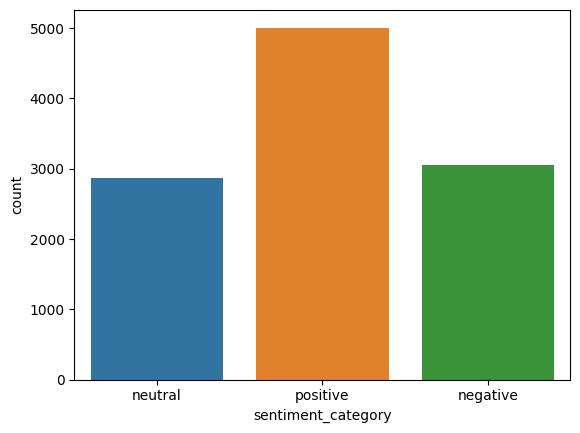

In [288]:
sns.countplot(data=club_merged,x='sentiment_category')

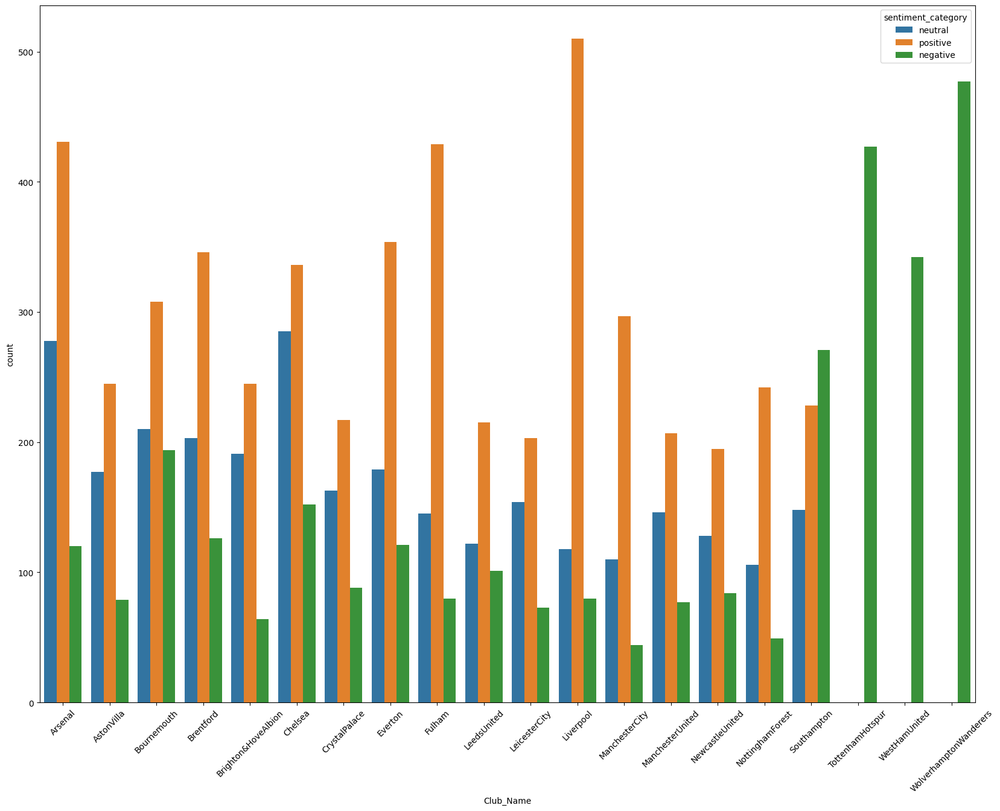

In [289]:
plt.figure(figsize = (20,15))
sns.countplot(data=club_merged,x='Club_Name',hue='sentiment_category')
plt.xticks(rotation = 45);

## Comibining Latitude and Longitude with the Sentiment Analysis Dataframe

In [290]:
club_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10920 entries, 0 to 12753
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   created_at             10920 non-null  object 
 1   id                     10920 non-null  int64  
 2   full_text              10920 non-null  object 
 3   retweet_count          10920 non-null  int64  
 4   favorite_count         10920 non-null  int64  
 5   user.id                10920 non-null  int64  
 6   user.name              10920 non-null  object 
 7   user.location          6815 non-null   object 
 8   user.followers_count   10920 non-null  int64  
 9   user.friends_count     10920 non-null  int64  
 10  user.favourites_count  10920 non-null  int64  
 11  Club_Name              10920 non-null  object 
 12  clean_text             10920 non-null  object 
 13  clean_text_2           10920 non-null  object 
 14  sentiment              9449 non-null   float64
 15  se

In [291]:
place_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568 entries, 0 to 567
Data columns (total 15 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id                        568 non-null    object 
 1   url                       568 non-null    object 
 2   place_type                568 non-null    object 
 3   name                      568 non-null    object 
 4   full_name                 568 non-null    object 
 5   country_code              568 non-null    object 
 6   country                   568 non-null    object 
 7   contained_within          568 non-null    object 
 8   bounding_box.type         568 non-null    object 
 9   bounding_box.coordinates  568 non-null    object 
 10  tweet_id                  568 non-null    int64  
 11  Club_Name                 568 non-null    object 
 12  Centroids                 568 non-null    object 
 13  Longitude                 568 non-null    float64
 14  Latitude  

In [296]:
merged_data = pd.merge(club_merged,place_merged, how='inner',left_on='id',right_on='tweet_id')

In [297]:
merged_data

,created_at,id_x,full_text,retweet_count,favorite_count,user.id,user.name,user.location,user.followers_count,user.friends_count,user.favourites_count,Club_Name_x,clean_text,clean_text_2,sentiment,sentiment_category,id_y,url,place_type,name,full_name,country_code,country,contained_within,bounding_box.type,bounding_box.coordinates,tweet_id,Club_Name_y,Centroids,Longitude,Latitude
0,Sun Mar 12 16:42:52 +0000 2023,1634958143343194112,@briantongo @Arsenal @TeamFuloZim Yep! Somethi...,0,0,733371448853692416,King Jay🇿🇼,"London, England",30186,13411,295491,Arsenal,Yep ! Something is definitely brewing there !,Yep ! Something is definitely brewing there !,0.6688,positive,13dd0eca94d322f1,https://api.twitter.com/1.1/geo/id/13dd0eca94d...,city,Basildon,"Basildon, East",GB,United Kingdom,[],Polygon,"[[0.3836341, 51.5463777], [0.530637, 51.546377...",1634958143343194112,Arsenal,"[0.45713555, 51.57042485]",0.457136,51.570425
1,Sun Mar 12 19:33:34 +0000 2023,1635001104193970176,It’s a great day to be a #gunner @Arsenal http...,0,0,1717293104,geremy.eth,"Miami, FL",164,898,1138,Arsenal,It ’ s a great day to be a gunner,It ’ s a great day to be a gunner,0.6249,positive,00ab941b685334e3,https://api.twitter.com/1.1/geo/id/00ab941b685...,city,Nashville,"Nashville, TN",US,United States,[],Polygon,"[[-87.022482, 35.9945681], [-86.560616, 35.994...",1635001104193970176,Arsenal,"[-86.791549, 36.20000805]",-86.791549,36.200008
2,Sat Mar 18 04:17:05 +0000 2023,1636944789512896512,@martinkelner @GedMills why do teams sack thei...,0,0,29671420,Craig Peter Dodd 🏴󠁧󠁢󠁥󠁮󠁧󠁿🇺🇦🇹🇷🇸🇾,"Windsor, Berkshire",6400,6335,37880,Arsenal,why do sack their manager just before they are...,why do sack their manager just before they are...,-0.1027,negative,06168d1feda43857,https://api.twitter.com/1.1/geo/id/06168d1feda...,admin,South East,"South East, England",GB,United Kingdom,[],Polygon,"[[-1.95729593780907, 50.5746064789388], [1.451...",1636944789512896512,Arsenal,"[-0.25275396881444, 51.38544574389945]",-0.252754,51.385446
3,Sat Mar 18 04:17:05 +0000 2023,1636944789512896512,@martinkelner @GedMills why do teams sack thei...,0,0,29671420,Craig Peter Dodd 🏴󠁧󠁢󠁥󠁮󠁧󠁿🇺🇦🇹🇷🇸🇾,"Windsor, Berkshire",6400,6335,37880,Arsenal,why do sack their manager just before they are...,why do sack their manager just before they are...,-0.1027,negative,06168d1feda43857,https://api.twitter.com/1.1/geo/id/06168d1feda...,admin,South East,"South East, England",GB,United Kingdom,[],Polygon,"[[-1.95729593780907, 50.5746064789388], [1.451...",1636944789512896512,Everton,"[-0.25275396881444, 51.38544574389945]",-0.252754,51.385446
4,Sat Mar 18 04:01:57 +0000 2023,1636940981906862080,I really like how the bass guitar sounds with ...,0,0,462594559,Will Dalton,"Greensboro, NC",282,405,2406,Arsenal,I really like how the bass guitar with a pep b...,I really like how the bass guitar with a pep b...,0.4201,positive,a6c257c61f294ec1,https://api.twitter.com/1.1/geo/id/a6c257c61f2...,city,Greensboro,"Greensboro, NC",US,United States,[],Polygon,"[[-80.0295184, 35.962623], [-79.6852086, 35.96...",1636940981906862080,Arsenal,"[-79.85736349999999, 36.090396999999996]",-79.857363,36.090397
5,Sun Mar 12 18:28:04 +0000 2023,1634984621032247296,Benrahma penalty scant relief for West Ham as ...,0,0,1614905156369260545,𝓟𝓻𝓮𝓼𝓼 𝓡𝓮𝓿𝓲𝓮𝔀,Italia,64,136,126,AstonVilla,penalty scant relief for West Ham as Villa poi...,penalty scant relief for West Ham as Villa poi...,-0.7067,negative,315b740b108481f6,https://api.twitter.com/1.1/geo/id/315b740b108...,city,Manchester,"Manchester, England",GB,United Kingdom,[],Polygon,"[[-2.319934, 53.343623], [-2.147026, 53.343623...",1634984621032247296,AstonVilla,"[-2.23348, 53.4569527]",-2.233480,53.456953
6,Wed Apr 05 17:51:42 +0000 2023,1643672775834443776,Looking at how vital the manager is to the tea...,0,0,2941888109,Akinmade Oluwatobiloba,"Abeokuta, Ogun state",1056,1848,67,AstonVilla,Looking at how vital the manager is to the tea...,Looking at how vital the manager is to the tea...,0.0000,neutra

In [298]:
merged_data[merged_data['tweet_id'].notnull()].shape

(76, 31)

In [300]:
merged_data_update = merged_data.drop_duplicates(subset=['id_x'],keep='first')

In [301]:
master_data = merged_data_update

In [302]:
master_data

,created_at,id_x,full_text,retweet_count,favorite_count,user.id,user.name,user.location,user.followers_count,user.friends_count,user.favourites_count,Club_Name_x,clean_text,clean_text_2,sentiment,sentiment_category,id_y,url,place_type,name,full_name,country_code,country,contained_within,bounding_box.type,bounding_box.coordinates,tweet_id,Club_Name_y,Centroids,Longitude,Latitude
0,Sun Mar 12 16:42:52 +0000 2023,1634958143343194112,@briantongo @Arsenal @TeamFuloZim Yep! Somethi...,0,0,733371448853692416,King Jay🇿🇼,"London, England",30186,13411,295491,Arsenal,Yep ! Something is definitely brewing there !,Yep ! Something is definitely brewing there !,0.6688,positive,13dd0eca94d322f1,https://api.twitter.com/1.1/geo/id/13dd0eca94d...,city,Basildon,"Basildon, East",GB,United Kingdom,[],Polygon,"[[0.3836341, 51.5463777], [0.530637, 51.546377...",1634958143343194112,Arsenal,"[0.45713555, 51.57042485]",0.457136,51.570425
1,Sun Mar 12 19:33:34 +0000 2023,1635001104193970176,It’s a great day to be a #gunner @Arsenal http...,0,0,1717293104,geremy.eth,"Miami, FL",164,898,1138,Arsenal,It ’ s a great day to be a gunner,It ’ s a great day to be a gunner,0.6249,positive,00ab941b685334e3,https://api.twitter.com/1.1/geo/id/00ab941b685...,city,Nashville,"Nashville, TN",US,United States,[],Polygon,"[[-87.022482, 35.9945681], [-86.560616, 35.994...",1635001104193970176,Arsenal,"[-86.791549, 36.20000805]",-86.791549,36.200008
2,Sat Mar 18 04:17:05 +0000 2023,1636944789512896512,@martinkelner @GedMills why do teams sack thei...,0,0,29671420,Craig Peter Dodd 🏴󠁧󠁢󠁥󠁮󠁧󠁿🇺🇦🇹🇷🇸🇾,"Windsor, Berkshire",6400,6335,37880,Arsenal,why do sack their manager just before they are...,why do sack their manager just before they are...,-0.1027,negative,06168d1feda43857,https://api.twitter.com/1.1/geo/id/06168d1feda...,admin,South East,"South East, England",GB,United Kingdom,[],Polygon,"[[-1.95729593780907, 50.5746064789388], [1.451...",1636944789512896512,Arsenal,"[-0.25275396881444, 51.38544574389945]",-0.252754,51.385446
4,Sat Mar 18 04:01:57 +0000 2023,1636940981906862080,I really like how the bass guitar sounds with ...,0,0,462594559,Will Dalton,"Greensboro, NC",282,405,2406,Arsenal,I really like how the bass guitar with a pep b...,I really like how the bass guitar with a pep b...,0.4201,positive,a6c257c61f294ec1,https://api.twitter.com/1.1/geo/id/a6c257c61f2...,city,Greensboro,"Greensboro, NC",US,United States,[],Polygon,"[[-80.0295184, 35.962623], [-79.6852086, 35.96...",1636940981906862080,Arsenal,"[-79.85736349999999, 36.090396999999996]",-79.857363,36.090397
5,Sun Mar 12 18:28:04 +0000 2023,1634984621032247296,Benrahma penalty scant relief for West Ham as ...,0,0,1614905156369260545,𝓟𝓻𝓮𝓼𝓼 𝓡𝓮𝓿𝓲𝓮𝔀,Italia,64,136,126,AstonVilla,penalty scant relief for West Ham as Villa poi...,penalty scant relief for West Ham as Villa poi...,-0.7067,negative,315b740b108481f6,https://api.twitter.com/1.1/geo/id/315b740b108...,city,Manchester,"Manchester, England",GB,United Kingdom,[],Polygon,"[[-2.319934, 53.343623], [-2.147026, 53.343623...",1634984621032247296,AstonVilla,"[-2.23348, 53.4569527]",-2.233480,53.456953
6,Wed Apr 05 17:51:42 +0000 2023,1643672775834443776,Looking at how vital the manager is to the tea...,0,0,2941888109,Akinmade Oluwatobiloba,"Abeokuta, Ogun state",1056,1848,67,AstonVilla,Looking at how vital the manager is to the tea...,Looking at how vital the manager is to the tea...,0.0000,neutral,00b1231d2214913c,https://api.twitter.com/1.1/geo/id/00b1231d221...,city,Abeokuta,"Abeokuta, Nigeria",NG,Nigeria,[],Polygon,"[[3.2713206, 7.0996682], [3.4335622, 7.0996682...",1643672775834443776,AstonVilla,"[3.3524414, 7.1544281000000005]",3.352441,7.154428
7,Wed Apr 05 17:19:42 +0000 2023,1643664723093643264,The Holte Suite is set and ready to go for Ast...,28,215,752814871834689536,Aston Villa Foundation,"Birmingham, England",22818,679,7747,AstonVilla,The Suite is set and ready to go for Villa ’ s...,The Suite is set and ready to go for Villa ’ s...,0.0000,neutral,53b67b1d1c

In [303]:
# Using + operator to combine two columns
master_data['Latitude-Longitude'] = master_data['Latitude'].astype(str) +", "+ master_data["Longitude"].astype(str)
#print(df)

<ipython-input-303-6b7a4d81f2f7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  master_data['Latitude-Longitude'] = master_data['Latitude'].astype(str) +", "+ master_data["Longitude"].astype(str)


In [111]:
master_data.to_csv('sentiment_master_data_updated.csv')

## Working on Centroids Data

In [306]:
centroids_df = pd.read_csv('/content/centroids_data.csv')

In [307]:
centroids_df

,id,url,place_type,name,full_name,country_code,country,bounding_box.coordinates,tweet_id,Club_Name,Centroids,Longitude,Latitude
0,34031d61ef79585f,https://api.twitter.com/1.1/geo/id/34031d61ef7...,city,Davie,"Davie, FL",US,United States,"[[-80.369507, 26.0295373], [-80.2008709, 26.02...",1.6332903128680653e+18,Arsenal,"[-80.28518894999999, 26.0781704]",-80.285189,26.078170
1,d66ca907ceb62690,https://api.twitter.com/1.1/geo/id/d66ca907ceb...,country,Jamaica,Jamaica,JM,Jamaica,"[[-78.3688776, 17.7057855], [-76.183028, 17.70...",1.6332997344157204e+18,Arsenal,"[-77.2759528, 18.1154073]",-77.275953,18.115407
2,01f06d712cfceb2f,https://api.twitter.com/1.1/geo/id/01f06d712cf...,city,Addo,"Addo, Nigeria",NG,Nigeria,"[[3.5750048, 6.4825679], [3.6243404, 6.4825679...",1.6332982805777408e+18,Arsenal,"[3.5996726, 6.4976807]",3.599673,6.497681
3,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.6335279436106547e+18,Arsenal,"[32.56916015, 0.28926745]",32.569160,0.289267
4,00d9827647c0ff5a,https://api.twitter.com/1.1/geo/id/00d9827647c...,admin,Dar es Salaam,"Dar es Salaam, Tanzania",TZ,Tanzania,"[[39.0081106, -7.1906489], [39.5566698, -7.190...",1.633527565133439e+18,Arsenal,"[39.2823902, -6.8788111999999995]",39.282390,-6.878811
5,13dd0eca94d322f1,https://api.twitter.com/1.1/geo/id/13dd0eca94d...,city,Basildon,"Basildon, East",GB,United Kingdom,"[[0.3836341, 51.5463777], [0.530637, 51.546377...",1.634958143343194e+18,Arsenal,"[0.45713555, 51.57042485]",0.457136,51.570425
6,8ef32ff56ef11c22,https://api.twitter.com/1.1/geo/id/8ef32ff56ef...,admin,England,"England, United Kingdom",GB,United Kingdom,"[[-6.3651943, 49.8825312], [1.768926, 49.88253...",1.6349987510342124e+18,Arsenal,"[-2.29813415, 52.84708985]",-2.298134,52.847090
7,3b77caf94bfc81fe,https://api.twitter.com/1.1/geo/id/3b77caf94bf...,city,Los Angeles,"Los Angeles, CA",US,United States,"[[-118.668404, 33.704538], [-118.155409, 33.70...",1.634998525036761e+18,Arsenal,"[-118.4119065, 34.0207895]",-118.411907,34.020789
8,00ab941b685334e3,https://api.twitter.com/1.1/geo/id/00ab941b685...,city,Nashville,"Nashville, TN",US,United States,"[[-87.022482, 35.9945681], [-86.560616, 35.994...",1.6350011041939702e+18,Arsenal,"[-86.791549, 36.20000805]",-86.791549,36.200008
9,06168d1feda43857,https://api.twitter.com/1.1/geo/id/06168d1feda...,admin,South East,"South East, England",GB,United Kingdom,"[[-1.95729593780907, 50.5746064789388], [1.451...",1.6369447895128965e+18,Arsenal,"[-0.25275396881444, 51.38544574389945]",-0.252754,51.385446


In [305]:
def clean_tweet_id(df):
  df['tweet_id'] = df['tweet_id'].replace('No Twitter ID','0')
  df['tweet_id'] = df['tweet_id'].astype('float')
  df['tweet_id'] = df['tweet_id'].astype('int')

  return df

In [308]:
centroids_df = clean_tweet_id(centroids_df)

In [309]:
centroids_df.shape

(441, 13)

In [310]:
centroids_df_merge = pd.merge(centroids_df,club_merged,how='left',left_on='tweet_id',right_on='id')

In [311]:
centroids_df_merge.head()

,id_x,url,place_type,name,full_name,country_code,country,bounding_box.coordinates,tweet_id,Club_Name_x,Centroids,Longitude,Latitude,created_at,id_y,full_text,retweet_count,favorite_count,user.id,user.name,user.location,user.followers_count,user.friends_count,user.favourites_count,Club_Name_y,clean_text,clean_text_2,sentiment,sentiment_category
0,34031d61ef79585f,https://api.twitter.com/1.1/geo/id/34031d61ef7...,city,Davie,"Davie, FL",US,United States,"[[-80.369507, 26.0295373], [-80.2008709, 26.02...",1633290312868065280,Arsenal,"[-80.28518894999999, 26.0781704]",-80.285189,26.078170,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,d66ca907ceb62690,https://api.twitter.com/1.1/geo/id/d66ca907ceb...,country,Jamaica,Jamaica,JM,Jamaica,"[[-78.3688776, 17.7057855], [-76.183028, 17.70...",1633299734415720448,Arsenal,"[-77.2759528, 18.1154073]",-77.275953,18.115407,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01f06d712cfceb2f,https://api.twitter.com/1.1/geo/id/01f06d712cf...,city,Addo,"Addo, Nigeria",NG,Nigeria,"[[3.5750048, 6.4825679], [3.6243404, 6.4825679...",1633298280577740800,Arsenal,"[3.5996726, 6.4976807]",3.599673,6.497681,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1633527943610654720,Arsenal,"[32.56916015, 0.28926745]",32.569160,0.289267,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,00d9827647c0ff5a,https://api.twitter.com/1.1/geo/id/00d9827647c...,admin,Dar es Salaam,"Dar es Salaam, Tanzania",TZ,Tanzania,"[[39.0081106, -7.1906489], [39.5566698, -7.190...",1633527565133438976,Arsenal,"[39.2823902, -6.8788111999999995]",39.282390,-6.878811,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [313]:
centroids_df_merge.size

12789

In [106]:
centroids_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 441 entries, 0 to 440
Data columns (total 13 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   id                        441 non-null    object 
 1   url                       441 non-null    object 
 2   place_type                441 non-null    object 
 3   name                      441 non-null    object 
 4   full_name                 441 non-null    object 
 5   country_code              441 non-null    object 
 6   country                   441 non-null    object 
 7   bounding_box.coordinates  441 non-null    object 
 8   tweet_id                  441 non-null    object 
 9   Club_Name                 441 non-null    object 
 10  Centroids                 441 non-null    object 
 11  Longitude                 441 non-null    float64
 12  Latitude                  441 non-null    float64
dtypes: float64(2), object(11)
memory usage: 44.9+ KB


### Sentiment Analysis Approach 2

In [135]:
club_centroids_id_df = pd.read_csv('/content/club_centroids_join_with_ids.csv')

In [137]:
club_centroids_id_df.head()

,id,url,place_type,name,full_name,country_code,country,bounding_box.coordinates,tweet_id,Club_Name,Centroids,Longitude,Latitude,bounding_box.type,contained_within,full_text
0,34031d61ef79585f,https://api.twitter.com/1.1/geo/id/34031d61ef7...,city,Davie,"Davie, FL",US,United States,"[[-80.369507, 26.0295373], [-80.2008709, 26.02...",1.633290e+18,Arsenal,"[-80.28518894999999, 26.0781704]",-80.285189,26.078170,NaN,NaN,NaN
1,d66ca907ceb62690,https://api.twitter.com/1.1/geo/id/d66ca907ceb...,country,Jamaica,Jamaica,JM,Jamaica,"[[-78.3688776, 17.7057855], [-76.183028, 17.70...",1.633300e+18,Arsenal,"[-77.2759528, 18.1154073]",-77.275953,18.115407,NaN,NaN,NaN
2,01f06d712cfceb2f,https://api.twitter.com/1.1/geo/id/01f06d712cf...,city,Addo,"Addo, Nigeria",NG,Nigeria,"[[3.5750048, 6.4825679], [3.6243404, 6.4825679...",1.633298e+18,Arsenal,"[3.5996726, 6.4976807]",3.599673,6.497681,NaN,NaN,NaN
3,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,"[32.56916015, 0.28926745]",32.569160,0.289267,Polygon,[],#Arsenal vintage vibes all the way 1998 to 200...
4,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,"[32.56916015, 0.28926745]",32.569160,0.289267,Polygon,[],@sethbamy Crystal Palace


In [138]:
club_centroids_id_df = club_centroids_id_df.drop_duplicates(subset=['tweet_id','full_text'],keep='last')

In [153]:
!pip install textblob

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [155]:
from textblob import TextBlob
from nltk.stem import SnowballStemmer
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from sklearn.feature_extraction.text import CountVectorizer

In [156]:
def percentage(part,whole):
 return 100 * float(part)/float(whole)

In [192]:
positive = 0
negative = 0
neutral = 0
polarity = 0
tweet_list = []
neutral_list = []
negative_list = []
positive_list = []

In [197]:
club_centroids_id_df = pd.read_csv('/content/club_centroids_join_with_ids.csv')

In [198]:
club_centroids_id_df = club_centroids_id_df.drop_duplicates(subset=['tweet_id','full_text'],keep='last')

In [199]:
club_centroids_id_df = club_centroids_id_df.dropna()

In [200]:
club_centroids_id_df.shape

(500, 16)

In [212]:
def clean_tweet(tweet):
    if type(tweet) == np.float:
        return ""
    r = tweet.lower()
    r = profanity.censor(r)
    r = re.sub("'", "", r)
    r = re.sub("@[A-Za-z0-9_]+","", r)
    r = re.sub("#[A-Za-z0-9_]+","", r)
    r = re.sub(r'http\S+', '', r)
    r = re.sub('[()!?]', ' ', r)
    r = re.sub('\[.*?\]',' ', r)
    r = re.sub("[^a-z0-9]"," ", r)
    r = r.split()
    stopwords = ["for", "on", "an", "a", "of", "and", "in", "the", "to", "from"]
    r = [w for w in r if not w in stopwords]
    r = " ".join(word for word in r)
    return r

In [213]:
club_centroids_id_df['clean_text'] = club_centroids_id_df['full_text'].apply(clean_tweet)

<ipython-input-212-3d5eefbed3e3>:2: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if type(tweet) == np.float:


In [214]:
club_centroids_id_df[['full_text','clean_text']].head(10)

,full_text,clean_text
3,#Arsenal vintage vibes all the way 1998 to 200...,vintage vibes all way 1998 2004 available play...
4,@sethbamy Crystal Palace,crystal palace
5,@Bryankamulegey9 Crystal palace,crystal palace
6,"When I watch yanga it reminds me@of arsenal, N...",when i watch yanga it reminds me arsenal nabi ...
7,"If Potter wins against Everton, he will win ma...",if potter wins against everton he will win man...
8,@briantongo @Arsenal @TeamFuloZim Yep! Somethi...,yep something is definitely brewing there
9,Arsenal won 3-0 at Craven Cottage on Sunday af...,arsenal won 3 0 at craven cottage sunday after...
10,Arsenal won 3-0 at Craven Cottage on Sunday af...,arsenal won 3 0 at craven cottage sunday after...
11,Trossard is the first player ever to assist fo...,trossard is first player ever assist arsenal m...
12,It’s a great day to be a #gunner @Arsenal http...,it s great day be


In [215]:
club_centroids_id_df[['polarity', 'subjectivity']] = club_centroids_id_df['clean_text'].apply(lambda x: pd.Series(TextBlob(x).sentiment))
for index, row in club_centroids_id_df['clean_text'].iteritems():
  score = SentimentIntensityAnalyzer().polarity_scores(row)
  neg = score['neg']
  neu = score['neu']
  pos = score['pos']
  comp = score['compound']
  if neg > pos:
    club_centroids_id_df.loc[index, 'sentiment'] = 'negative'
  elif pos > neg:
    club_centroids_id_df.loc[index, 'sentiment'] = 'positive'
  else:
    club_centroids_id_df.loc[index, 'sentiment'] = 'neutral'
    club_centroids_id_df.loc[index, 'neg'] = neg
    club_centroids_id_df.loc[index, 'neu'] = neu
    club_centroids_id_df.loc[index, 'pos'] = pos
    club_centroids_id_df.loc[index, 'compound'] = comp

<ipython-input-215-bf17369bf21d>:2: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for index, row in club_centroids_id_df['clean_text'].iteritems():


In [216]:
club_centroids_id_df[['clean_text','polarity','subjectivity','sentiment']]

,clean_text,polarity,subjectivity,sentiment
3,vintage vibes all way 1998 2004 available play...,0.258333,0.716667,positive
4,crystal palace,0.000000,0.000000,neutral
5,crystal palace,0.000000,0.000000,neutral
6,when i watch yanga it reminds me arsenal nabi ...,0.000000,0.000000,positive
7,if potter wins against everton he will win man...,0.550000,0.300000,positive
8,yep something is definitely brewing there,0.000000,0.500000,positive
9,arsenal won 3 0 at craven cottage sunday after...,0.350000,0.350000,positive
10,arsenal won 3 0 at craven cottage sunday after...,0.350000,0.350000,positive
11,trossard is first player ever assist arsenal m...,-0.050000,0.244444,neutral
12,it s great day be,0.800000,0.750000,positive


In [219]:
club_centroids_id_df['Latitude-Longitude'] = club_centroids_id_df['Latitude'].astype(str) +", "+ club_centroids_id_df["Longitude"].astype(str)

In [220]:
club_centroids_id_df.to_csv('club_centroid_join_id_sentiment1_updated.csv',encoding='utf-8', index = False)

In [217]:
club_centroids_id_df['sentiment'].value_counts()

positive    245
negative    188
neutral      67
Name: sentiment, dtype: int64

In [6]:
club_centroids_id_df = pd.read_csv('/content/club_centroid_join_id_sentiment1_updated.csv')

In [7]:
club_centroids_id_df.head()

,id,url,place_type,name,full_name,country_code,country,bounding_box.coordinates,tweet_id,Club_Name,...,full_text,clean_text,polarity,subjectivity,sentiment,neg,neu,pos,compound,Latitude-Longitude
0,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,...,#Arsenal vintage vibes all the way 1998 to 200...,vintage vibes all way 1998 2004 available play...,0.258333,0.716667,positive,NaN,NaN,NaN,NaN,"0.28926745, 32.56916015"
1,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,...,@sethbamy Crystal Palace,crystal palace,0.000000,0.000000,neutral,0.0,1.0,0.0,0.0,"0.28926745, 32.56916015"
2,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,...,@Bryankamulegey9 Crystal palace,crystal palace,0.000000,0.000000,neutral,0.0,1.0,0.0,0.0,"0.28926745, 32.56916015"
3,00d9827647c0ff5a,https://api.twitter.com/1.1/geo/id/00d9827647c...,admin,Dar es Salaam,"Dar es Salaam, Tanzania",TZ,Tanzania,"[[39.0081106, -7.1906489], [39.5566698, -7.190...",1.633528e+18,Arsenal,...,"When I watch yanga it reminds me@of arsenal, N...",when i watch yanga it reminds me arsenal nabi ...,0.000000,0.000000,positive,NaN,NaN,NaN,NaN,"-6.8788112, 39.2823902"
4,00d9827647c0ff5a,https://api.twitter.com/1.1/geo/id/00d9827647c...,admin,Dar es Salaam,"Dar es Salaam, Tanzania",TZ,Tanzania,"[[39.0081106, -7.1906489], [39.5566698, -7.190...",1.633528e+18,Arsenal,...,"If Potter wins against Everton, he will win ma...",if potter wins against everton he will win man...,0.550000,0.300000,positive,NaN,NaN,NaN,NaN,"-6.8788112, 39.2823902"


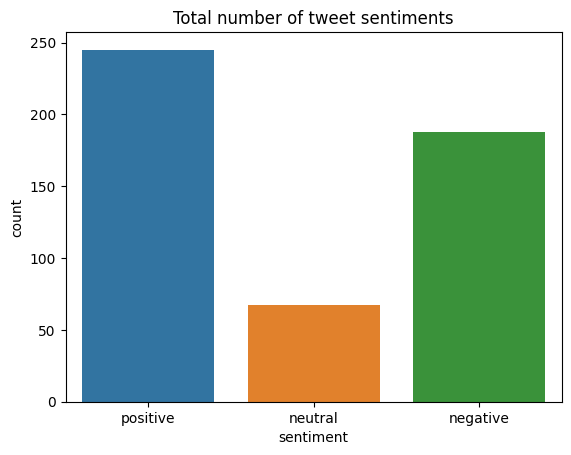

In [37]:
sns.countplot(data=club_centroids_id_df,x='sentiment')
plt.title('Total number of tweet sentiments');

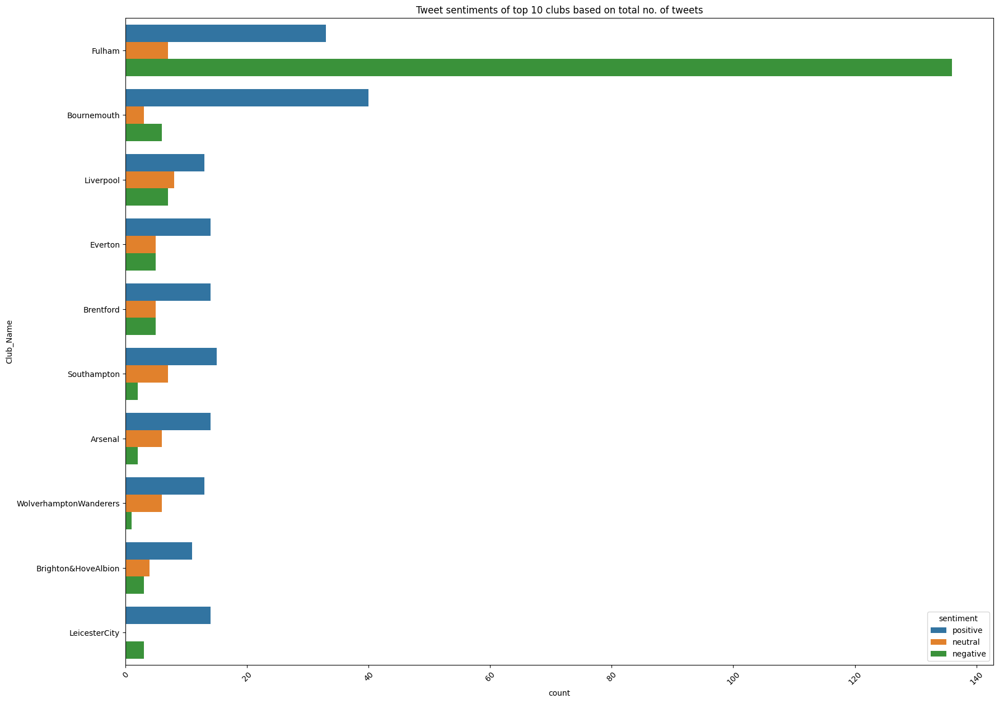

In [38]:
plt.figure(figsize = (20,15))
sns.countplot(data=club_centroids_id_df,y='Club_Name',hue='sentiment',order=club_centroids_id_df['Club_Name'].value_counts().head(10).index)
plt.xticks(rotation = 45);
plt.title('Tweet sentiments of top 10 clubs based on total no. of tweets');

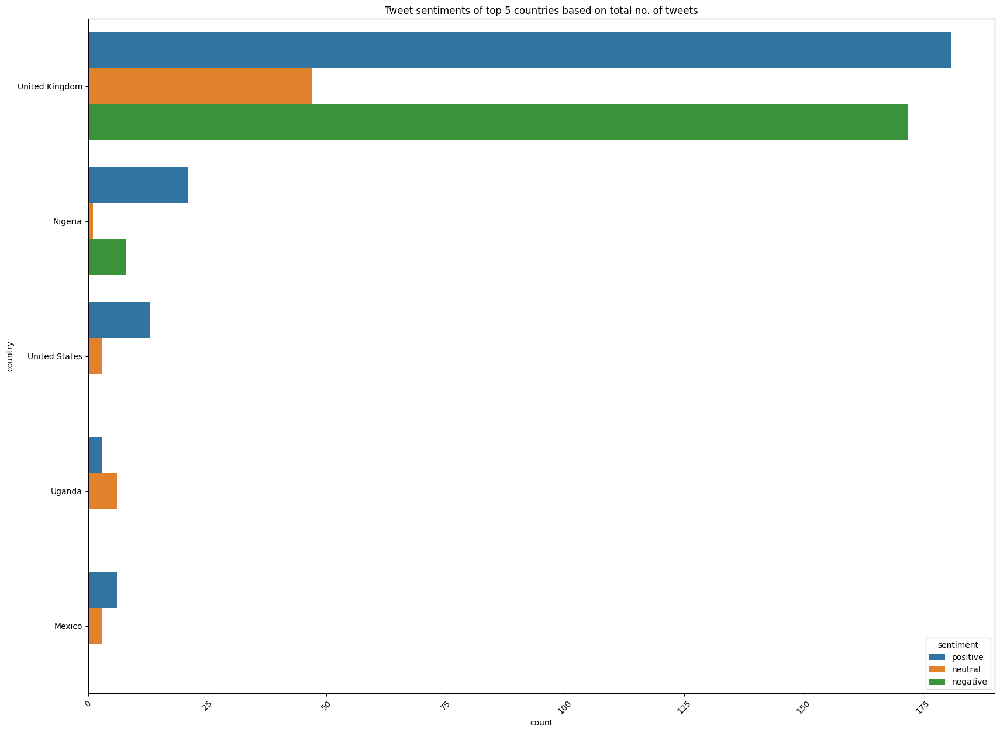

In [39]:
plt.figure(figsize = (20,15))
sns.countplot(data=club_centroids_id_df,y='country',hue='sentiment',order=club_centroids_id_df['country'].value_counts().head(5).index)
plt.xticks(rotation = 45);
plt.title('Tweet sentiments of top 5 countries based on total no. of tweets');

In [13]:
club_centroids_id_df

,id,url,place_type,name,full_name,country_code,country,bounding_box.coordinates,tweet_id,Club_Name,...,full_text,clean_text,polarity,subjectivity,sentiment,neg,neu,pos,compound,Latitude-Longitude
0,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,...,#Arsenal vintage vibes all the way 1998 to 200...,vintage vibes all way 1998 2004 available play...,0.258333,0.716667,positive,NaN,NaN,NaN,NaN,"0.28926745, 32.56916015"
1,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,...,@sethbamy Crystal Palace,crystal palace,0.000000,0.000000,neutral,0.0,1.0,0.0,0.0,"0.28926745, 32.56916015"
2,000c69ad123213a8,https://api.twitter.com/1.1/geo/id/000c69ad123...,admin,Kampala,"Kampala, Uganda",UG,Uganda,"[[32.4166234, 0.1648531], [32.7216969, 0.16485...",1.633528e+18,Arsenal,...,@Bryankamulegey9 Crystal palace,crystal palace,0.000000,0.000000,neutral,0.0,1.0,0.0,0.0,"0.28926745, 32.56916015"
3,00d9827647c0ff5a,https://api.twitter.com/1.1/geo/id/00d9827647c...,admin,Dar es Salaam,"Dar es Salaam, Tanzania",TZ,Tanzania,"[[39.0081106, -7.1906489], [39.5566698, -7.190...",1.633528e+18,Arsenal,...,"When I watch yanga it reminds me@of arsenal, N...",when i watch yanga it reminds me arsenal nabi ...,0.000000,0.000000,positive,NaN,NaN,NaN,NaN,"-6.8788112, 39.2823902"
4,00d9827647c0ff5a,https://api.twitter.com/1.1/geo/id/00d9827647c...,admin,Dar es Salaam,"Dar es Salaam, Tanzania",TZ,Tanzania,"[[39.0081106, -7.1906489], [39.5566698, -7.190...",1.633528e+18,Arsenal,...,"If Potter wins against Everton, he will win ma...",if potter wins against everton he will win man...,0.550000,0.300000,positive,NaN,NaN,NaN,NaN,"-6.8788112, 39.2823902"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,7de31e05e99a00f8,https://api.twitter.com/1.1/geo/id/7de31e05e99...,city,Bournemouth,"Bournemouth, England",GB,United Kingdom,"[[-1.93759, 50.7095004], [-1.7676241, 50.70950...",1.644402e+18,WolverhamptonWanderers,...,No rest for the wicked as Coombsy and Humber r...,no rest wicked as coombsy humber race back tau...,0.200000,0.300000,positive,NaN,NaN,NaN,NaN,"50.7422682, -1.85260705"
496,7de31e05e99a00f8,https://api.twitter.com/1.1/geo/id/7de31e05e99...,city,Bournemouth,"Bournemouth, England",GB,United Kingdom,"[[-1.93759, 50.7095004], [-1.7676241, 50.70950...",1.644402e+18,WolverhamptonWanderers,...,@Beigemania Finally ! Hope is here ! 🙏 rainin...,finally hope is here raining like mad bournemouth,-0.312500,1.000000,positive,NaN,NaN,NaN,NaN,"50.7422682, -1.85260705"
497,7de31e05e99a00f8,https://api.twitter.com/1.1/geo/id/7de31e05e99...,city,Bournemouth,"Bournemouth, England",GB,United Kingdom,"[[-1.93759, 50.7095004], [-1.7676241, 50.70950...",1.644402e+18,WolverhamptonWanderers,...,Lip filler in Bournemouth - our award winning ...,lip filler bournemouth our award winning aesth...,0.356250,0.436250,positive,NaN,NaN,NaN,NaN,"50.7422682, -1.85260705"
498,7de31e05e99a00f8,https://api.twitter.com/1.1/geo/id/7de31e05e99...,city,Bournemouth,"Bournemouth, England",GB,United Kingdom,"[[-1.93759, 50.7095004], [-1.7676241, 50.70950...",1.644402e+18,WolverhamptonWanderers,...,Looking forward to this one and seeing a few f...,looking forward this one seeing few family fri...,-0.200000,0.100000,positive,NaN,NaN,NaN,NaN,"50.7422682, -1.85260705"
